In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import ConvexHull
from scipy.optimize import curve_fit
from sklearn.metrics import root_mean_squared_error as rmse

import seir_discrete
import switch

%load_ext autoreload
%autoreload 2

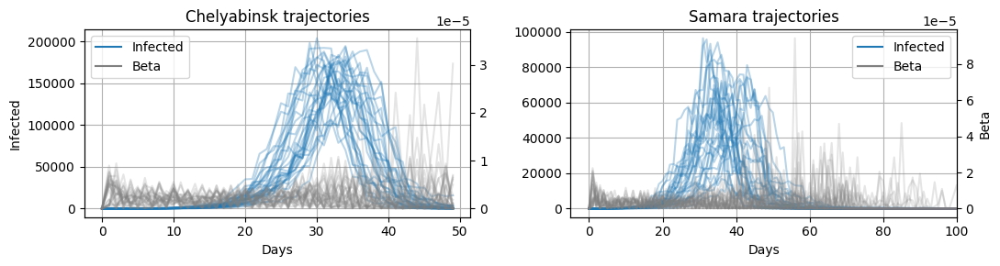

In [38]:
fig, axes = plt.subplots(1, 2, figsize=(11, 3))
ax = axes.flatten()

for idx, city, city_l in zip([0,1], 
                             ['full_chel_recalc','sampled_200k_recalc'],
                             ['Chelyabinsk', 'Samara']):
    ax_b = ax[idx].twinx()
    for i in range(30):
        if i == 0:
            label_i = 'Infected'
            label_b = 'Beta'
        else:
            label_i = ''
            label_b = ''
        df = pd.read_csv(f'{city}/seirb_seed_{i}.csv')
        ax[idx].plot(df.I_H1N1, color='tab:blue', alpha=0.3,
                    label=label_i)
        ax_b.plot(df.beta_H1N1, color='gray', alpha=0.2,
                 label=label_b)
        
    if city=='sampled_200k_recalc':
        ax[idx].set_xlim(-5, 100)
        
    ax[idx].grid()
    
    lines1, labels1 = ax[idx].get_legend_handles_labels()
    lines2, labels2 = ax_b.get_legend_handles_labels()
    ll = ax[idx].legend(lines1 + lines2, labels1 + labels2)
    for lh in ll.legend_handles:
        lh.set_alpha(1)
    
    if idx == 0:
        ax[idx].set_ylabel('Infected')
    if idx == 1:
        ax_b.set_ylabel('Beta')
    
    ax[idx].set_xlabel('Days')
        
    ax[idx].set_title(f'{city_l} trajectories')
    
plt.tight_layout()
plt.savefig(f'cities_traj.pdf', 
           format='pdf', dpi=300, bbox_inches='tight')    

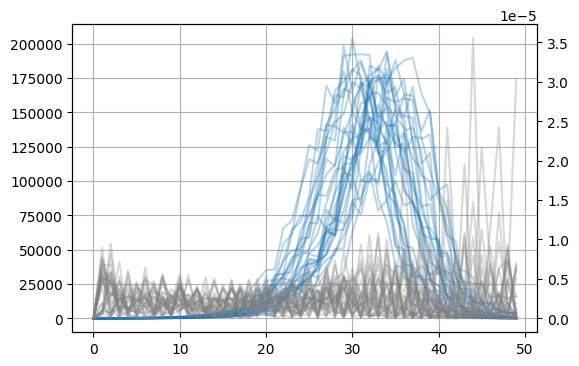

In [2]:
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_b = ax.twinx()
for i in range(30):
    df = pd.read_csv(f'full_chel_recalc/seirb_seed_{i}.csv')
    ax.plot(df.I_H1N1, color='tab:blue', alpha=0.3)
    ax_b.plot(df.beta_H1N1, color='gray', alpha=0.3)

ax.grid()

(-5.0, 100.0)

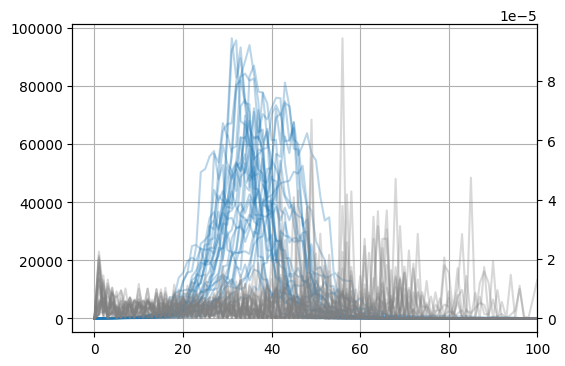

In [4]:
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_b = ax.twinx()
for i in range(30):
    df = pd.read_csv(f'sampled_200k_recalc/seirb_seed_{i}.csv')
    ax.plot(df.I_H1N1, color='tab:blue', alpha=0.3)
    ax_b.plot(df.beta_H1N1, color='gray', alpha=0.3)

ax.grid()
ax.set_xlim(-5, 100)

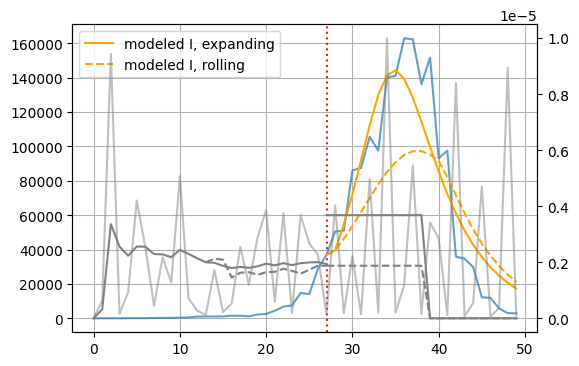

In [204]:
df_b = pd.read_csv(f'full_chel_recalc/seirb_seed_{0}.csv')

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_b = ax.twinx()

ax.plot(df_b.I_H1N1, color='tab:blue', alpha=0.7)
ax_b.plot(df_b.beta_H1N1, color='gray', alpha=0.5)



st_day = 27
fin = df_b.shape[0]
ax.axvline(st_day, ls=':',color='tab:red')
y0 = df_b.iloc[st_day,:4].values
ts = np.arange(fin-st_day)
sigma = 1/2
gamma = 1/6

pred_days = fin-st_day
large_days = 12
rest_days = pred_days-large_days

beta_exp = df_b.beta_H1N1.expanding().mean()
ax_b.plot(beta_exp.iloc[:st_day+1], color='gray')

bb = [*[beta_exp.iloc[st_day]*1.9]*large_days, 
      *[0]*rest_days]
ax_b.plot(np.arange(st_day, fin), bb, color='gray')
S,E,I,R = seir_discrete.seir_model(y0, ts, bb,
                                   sigma, gamma, stype='d', 
                                   beta_t=True).T
ax.plot(ts+st_day, I, color='orange', ls='-', alpha=1, label='modeled I, expanding')


beta_roll = df_b.beta_H1N1.rolling(14).mean()
ax_b.plot(beta_roll.iloc[:st_day+1], color='gray', ls='--')

bb = [*[beta_roll.iloc[st_day]]*large_days, 
      *[0]*rest_days]
ax_b.plot(np.arange(st_day, fin), bb, color='gray', ls='--')
S,E,I,R = seir_discrete.seir_model(y0, ts, bb,
                                   sigma, gamma, stype='d', 
                                   beta_t=True).T
ax.plot(ts+st_day, I, color='orange', ls='--', alpha=1, label='modeled I, rolling')

ax.grid()
ax.legend()

In [ ]:
df_b

ValueError: x and y must have same first dimension, but have shapes (20,) and (25,)

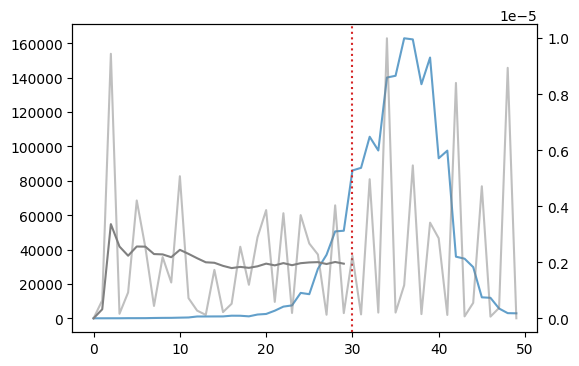

In [198]:
df_b = pd.read_csv(f'full_chel_recalc/seirb_seed_{0}.csv')

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_b = ax.twinx()

ax.plot(df_b.I_H1N1, color='tab:blue', alpha=0.7)
ax_b.plot(df_b.beta_H1N1, color='gray', alpha=0.5)
beta_exp = df_b.beta_H1N1.expanding().mean()
ax_b.plot(beta_exp.iloc[:st_day+1], color='gray')


st_day = 30
fin = df_b.shape[0]
ax.axvline(st_day, ls=':',color='tab:red')
y0 = df_b.iloc[st_day,:4].values
ts = np.arange(fin-st_day)
sigma = 1/2
gamma = 1/6


bb = [*[beta_exp.iloc[st_day]]*large_days, 
      *[0]*rest_days]
ax_b.plot(np.arange(st_day, fin), bb, color='gray')
S,E,I,R = seir_discrete.seir_model(y0, ts, bb,
                                   sigma, gamma, stype='d', 
                                   beta_t=True).T
ax.plot(ts+st_day, I, color='orange', ls='-', alpha=1, label='modeled I, expanding')


ax.grid()
ax.legend()

## many constant betas

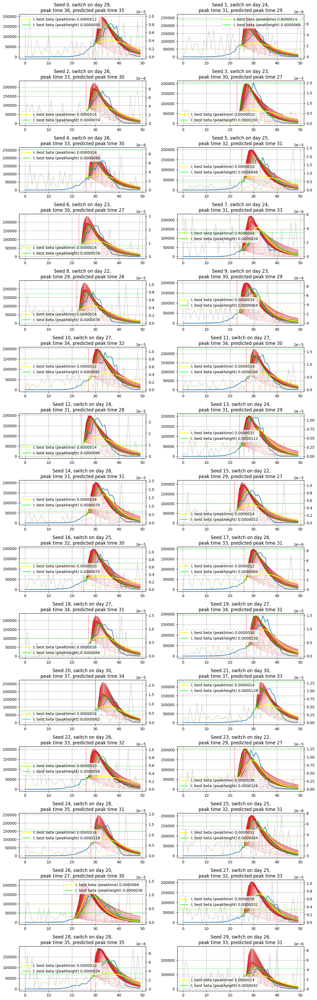

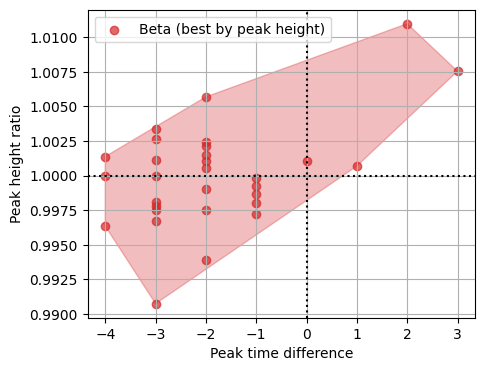

In [92]:
switch.constant_betas_all(days_before=7, sigma=1/2, gamma=1/6,
                         folder = 'full_chel_recalc', 
                          n_seeds=30)

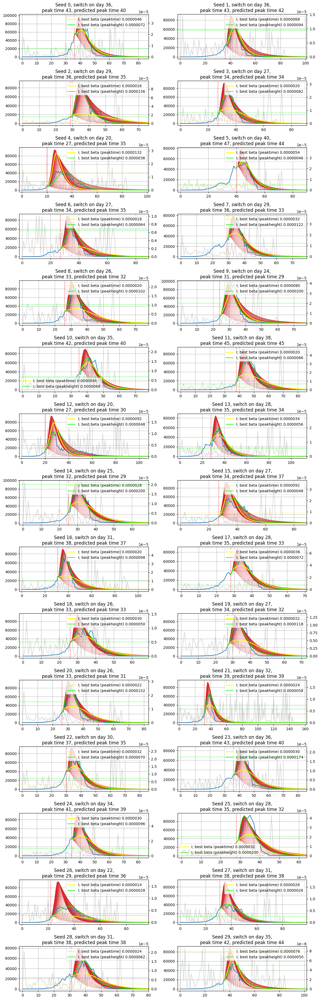

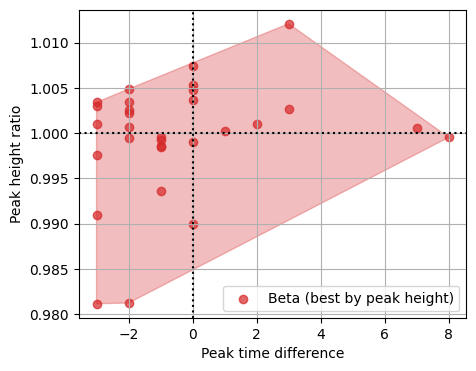

In [93]:
switch.constant_betas_all(days_before=7, sigma=1/2, gamma=1/6,
                         folder = 'sampled_200k_recalc', 
                          n_seeds=30)

## 3 betas (last, rolling, expanding)

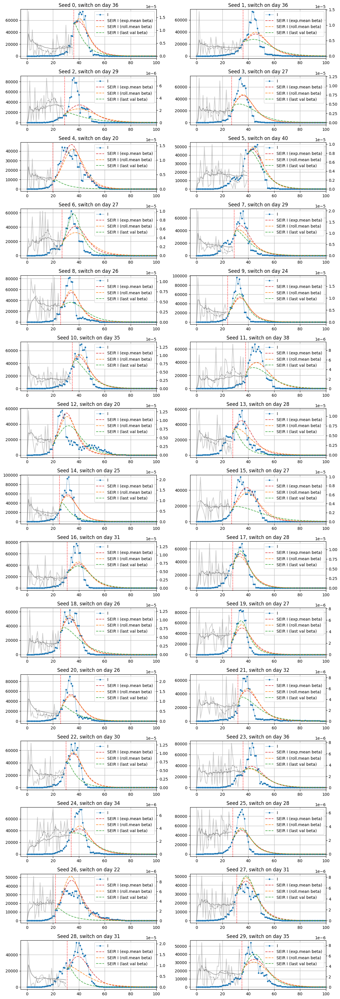

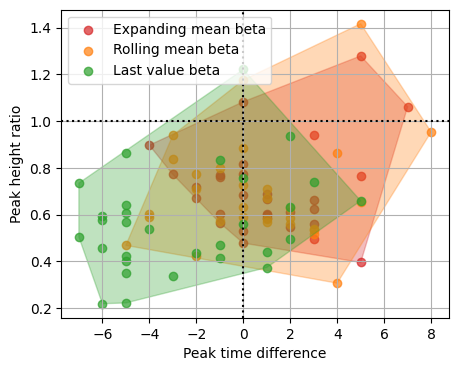

In [85]:
r = switch.plot_hybrid(switch_method=7, 
                sigma=1/2, gamma=1/6, plot_traj=True,
            folder= 'sampled_200k_recalc')

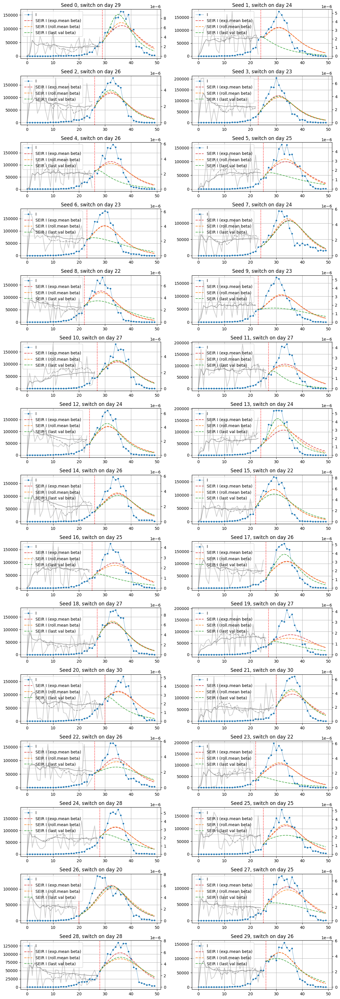

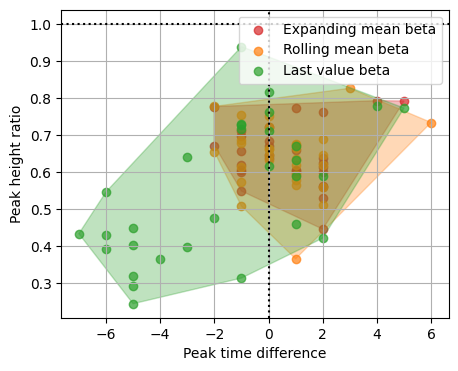

In [87]:
r = switch.plot_hybrid(switch_method=7, 
                sigma=1/2, gamma=1/6, plot_traj=True,
            folder= 'full_chel_recalc')

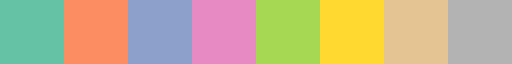

In [74]:
cmap

In [67]:
import matplotlib as mpl
cmap = mpl.colormaps['Set2']
# Take colors at regular intervals spanning the colormap.
#colors = cmap(np.linspace(0, 1, 3))
colors = list(cmap)
colors

TypeError: 'ListedColormap' object is not iterable

In [70]:
cmap.colors[:3]

((0.4, 0.7607843137254902, 0.6470588235294118),
 (0.9882352941176471, 0.5529411764705883, 0.3843137254901961),
 (0.5529411764705883, 0.6274509803921569, 0.796078431372549))

In [66]:
cmap[:3]

TypeError: 'ListedColormap' object is not subscriptable

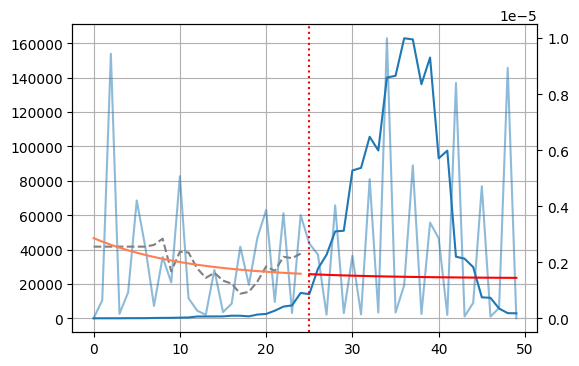

In [46]:
start_day=25
df = pd.read_csv(f'full_chel_recalc/seirb_seed_{0}.csv')

def func(x, a, b, c):
    return a*np.exp(-b*x) + c

given_betas=df.beta_H1N1[:start_day]

duration=df.shape[0]-start_day

y_data = given_betas.rolling(7).mean().bfill()
x = np.arange(y_data.shape[0])

popt, pcov = curve_fit(func, x, y_data)

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_b = ax.twinx()

ax_b.plot(df.beta_H1N1, alpha=0.5)
ax.plot(df.I_H1N1)
ax_b.plot(y_data, color='gray', ls='--')

ax.axvline(start_day, ls=':', color='red')
ax_b.plot(np.arange(start_day),
         func(np.arange(start_day), *popt), color='coral')
ax_b.plot(np.arange(start_day,df.shape[0]),
         func(np.arange(start_day,df.shape[0]), *popt), color='red')

ax.grid()

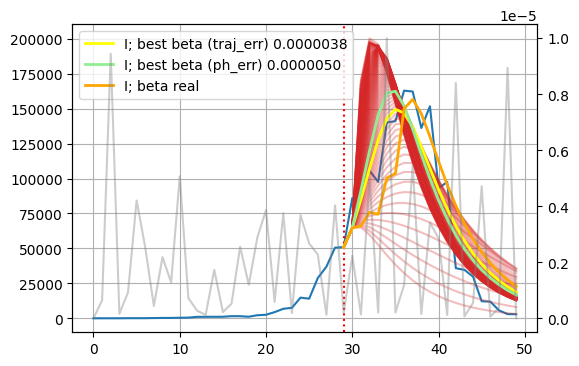

In [146]:
i=0

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_beta = ax.twinx()

folder = 'full_chel_recalc/'
df_b = pd.read_csv(f'{folder}/seirb_seed_{i}.csv')
fin = df_b.shape[0]
real_peakt = df_b.I_H1N1.argmax()
real_peakh = df_b.I_H1N1.max()
st_day = real_peakt - 7
ax.plot(df_b.I_H1N1)

betas = df_b.beta_H1N1
ax_beta.plot(betas, color='gray', alpha=0.4, label='beta from df')


ax.axvline(st_day, ls=':', color='red')

y0 = df_b.iloc[st_day,:4].values
ts = np.arange(fin-st_day)
sigma = 1/2
gamma = 1/6

res_dict = dict()
for b in np.arange(0.0, 2e-5, 2e-7):
    #ax_beta.plot(b, ls='--', color='tab:green')
    S,E,I,R = seir_discrete.seir_model(y0, ts, b, 
                                       sigma, gamma, stype='d', 
                                       beta_t=False).T
    ax.plot(ts+st_day, I, color='tab:red', ls='-', alpha=0.3)
    
    predicted_peakt = I.argmax()+st_day
    predicted_peakh = I.max()

    pt_err = abs(real_peakt - predicted_peakt)
    ph_err = abs(real_peakh - predicted_peakh)
    traj_err = rmse(df_b.I_H1N1.iloc[st_day:], I) 
    res_dict[b] = [pt_err,ph_err,traj_err]
    
    
    
best_b = pd.DataFrame.from_dict(res_dict).T.reset_index()
best_b.columns = ['beta', 'pt_err', 'ph_err', 'traj_err']

best_b_peak_time = best_b.nsmallest(1,'traj_err').iloc[0,0]   
S,E,Ib,R = seir_discrete.seir_model(y0, ts, best_b_peak_time, 
                                     sigma, gamma, stype='d', 
                                   beta_t=False).T
ax.plot(ts+st_day, Ib, color='yellow', ls='-', alpha=1, lw=2,
                    label=f'I; best beta (traj_err) {best_b_peak_time:.7f}')   


best_b_peak_time = best_b.nsmallest(1,'ph_err').iloc[0,0]   
S,E,Ib,R = seir_discrete.seir_model(y0, ts, best_b_peak_time, 
                                     sigma, gamma, stype='d', 
                                   beta_t=False).T
ax.plot(ts+st_day, Ib, color='lightgreen', ls='-', alpha=1, lw=2,
                    label=f'I; best beta (ph_err) {best_b_peak_time:.7f}')         


S,E,Ib,R = seir_discrete.seir_model(y0, ts, betas.iloc[st_day:].values, 
                                     sigma, gamma, stype='d', 
                                   beta_t=True).T
ax.plot(ts+st_day, Ib, color='orange', ls='-', alpha=1, lw=2,
                    label=f'I; beta real')         

ax.grid()
#ax.set_xlim(40,80)
ax.legend()

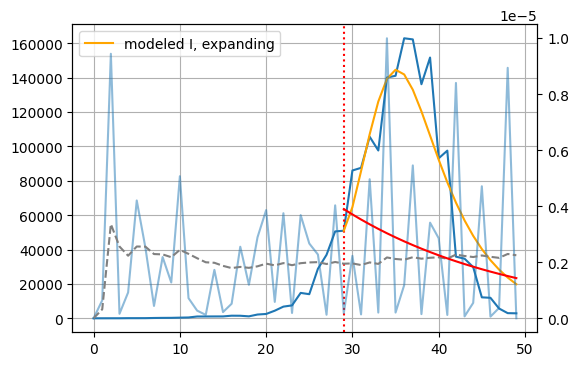

In [197]:
df = pd.read_csv(f'full_chel_recalc/seirb_seed_{0}.csv')

def func(t, b0, phi, q):
    return b0*( (1-phi)*np.exp(-q*t) + phi)

start_day = df.I_H1N1.argmax()-7
beta_e = df.beta_H1N1.expanding(1).mean().bfill()

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_b = ax.twinx()

ax.plot(df.I_H1N1)
ax_b.plot(df.beta_H1N1, alpha=0.5)
ax_b.plot(beta_e, color='gray', ls='--')

days = np.arange(start_day,df.shape[0])
b0 = beta_e[start_day]*2
phi = (1/2)*b0
q = 0.05

ax.axvline(start_day, ls=':', color='red')
ax_b.plot(days,
          func(days-start_day , b0, phi, q), 
          color='red')

y0 = df_b.iloc[start_day,:4].values
bb = func(days-start_day , b0, phi, q)
S,E,I,R = seir_discrete.seir_model(y0, days-start_day, bb,
                                   sigma, gamma, stype='d', 
                                   beta_t=True).T
ax.plot(days, I, color='orange', ls='-', 
        alpha=1, label='modeled I, expanding')

ax.grid()
ax.legend()

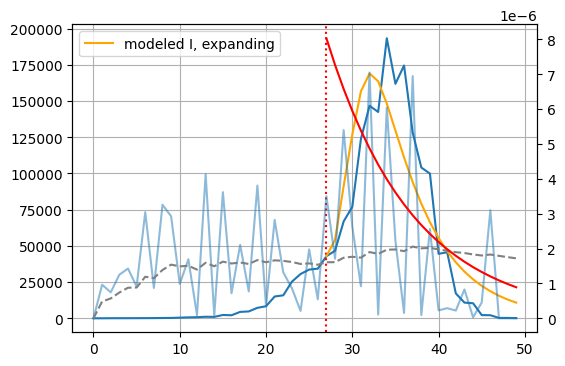

In [188]:
df = pd.read_csv(f'full_chel_recalc/seirb_seed_{19}.csv')

def func(t, b0, phi, q):
    return b0*( (1-phi)*np.exp(-q*t) + phi)

start_day = df.I_H1N1.argmax()-7
beta_e = df.beta_H1N1.expanding(1).mean().bfill()

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_b = ax.twinx()

ax.plot(df.I_H1N1)
ax_b.plot(df.beta_H1N1, alpha=0.5)
ax_b.plot(beta_e, color='gray', ls='--')

days = np.arange(start_day,df.shape[0])
b0 = beta_e[start_day]*5
phi = (1/2)*b0
q = 0.1

ax.axvline(start_day, ls=':', color='red')
ax_b.plot(days,
          func(days-start_day , b0, phi, q), 
          color='red')

y0 = df.iloc[start_day,:4].values
bb = func(days-start_day , b0, phi, q)
S,E,I,R = seir_discrete.seir_model(y0, days-start_day, bb,
                                   sigma, gamma, stype='d', 
                                   beta_t=True).T
ax.plot(days, I, color='orange', ls='-', 
        alpha=1, label='modeled I, expanding')

ax.grid()
ax.legend()

In [102]:
t.shape[0]

25

In [81]:
np.arange(start_day,df.shape[0])/49

array([0.51020408, 0.53061224, 0.55102041, 0.57142857, 0.59183673,
       0.6122449 , 0.63265306, 0.65306122, 0.67346939, 0.69387755,
       0.71428571, 0.73469388, 0.75510204, 0.7755102 , 0.79591837,
       0.81632653, 0.83673469, 0.85714286, 0.87755102, 0.89795918,
       0.91836735, 0.93877551, 0.95918367, 0.97959184, 1.        ])

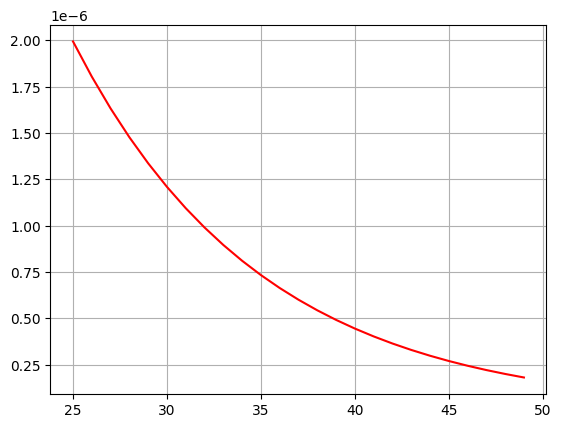

In [97]:
t = np.arange(25)
b0 = beta_e[start_day]
phi = 1/4*b0
q = 0.1
plt.plot(np.arange(start_day,df.shape[0]),
          func(t, b0, phi, q), 
          color='red')
plt.grid()

In [67]:
beta_e[start_day]

1.9932374970632338e-06

In [214]:

df.iloc[:,:5]

[autoreload of plot_hyb failed: Traceback (most recent call last):
  File "C:\Users\user\anaconda3\envs\abm_sier_rnf\Lib\site-packages\IPython\extensions\autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "C:\Users\user\anaconda3\envs\abm_sier_rnf\Lib\site-packages\IPython\extensions\autoreload.py", line 475, in superreload
    module = reload(module)
             ^^^^^^^^^^^^^^
  File "C:\Users\user\anaconda3\envs\abm_sier_rnf\Lib\importlib\__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 621, in _exec
  File "<frozen importlib._bootstrap_external>", line 936, in exec_module
  File "<frozen importlib._bootstrap_external>", line 1074, in get_code
  File "<frozen importlib._bootstrap_external>", line 1004, in source_to_code
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "C:\Users\user\Documents\GitHub\ABM_gen\plot_hyb.py", line 181
    seed_df = see

,S_H1N1,E_H1N1,I_H1N1,R_H1N1,beta_H1N1
0,311982.0,8.0,10.0,88000.0,-0.000000e+00
1,311980.0,10.0,10.0,88000.0,6.410667e-07
2,311927.0,55.0,18.0,88000.0,9.439531e-06
3,311926.0,54.0,20.0,88000.0,1.602944e-07
4,311905.0,22.0,73.0,88000.0,9.223040e-07
5,311808.0,118.0,74.0,88000.0,4.203904e-06
6,311741.0,164.0,85.0,88010.0,2.528494e-06
7,311716.0,92.0,182.0,88010.0,4.406660e-07
8,311552.0,189.0,241.0,88018.0,2.184219e-06
9,311447.0,269.0,264.0,88020.0,1.277030e-06


KeyError: 25

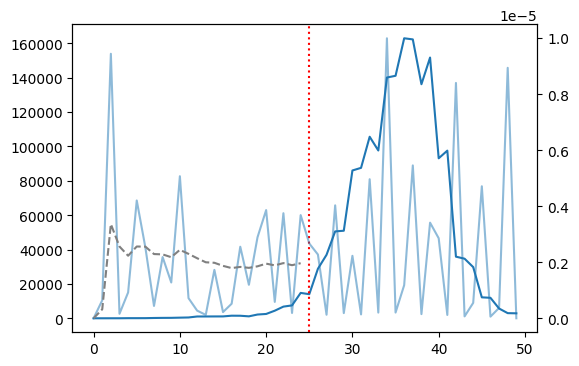

In [215]:
start_day=25
df = pd.read_csv(f'full_chel_recalc/seirb_seed_{0}.csv')

def func(t, b0, phi, q):
    return b0*( (1-phi)*np.exp(-q*t) + phi)


beta_e = given_betas.expanding(1).mean().bfill()
t = np.arange(beta_e.shape[0])


fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax_b = ax.twinx()

ax.plot(df.I_H1N1)
ax_b.plot(df.beta_H1N1, alpha=0.5)
ax_b.plot(beta_e, color='gray', ls='--')

ax.axvline(start_day, ls=':', color='red')
ax_b.plot(np.arange(start_day,df.shape[0]),
         func(np.arange(start_day,df.shape[0]), beta_e[start_day], ), 
          color='red')

ax.grid()

## applying our prev.methods (1st group)

In [41]:
import plot_hyb
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


last value


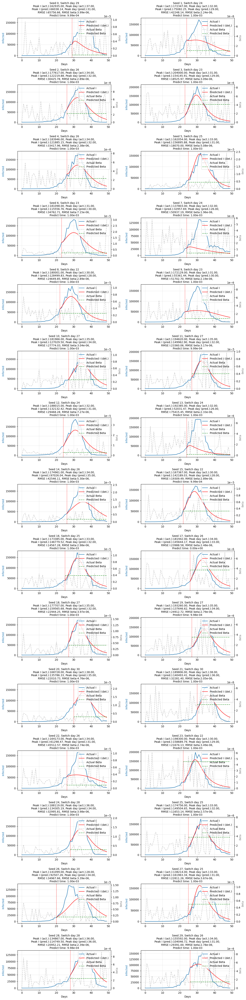

In [52]:
methods = ['last value', 'rolling mean last value',
           'expanding mean last value', 'biexponential decay']
            #'median beta', 'median beta;\nshifted forecast']
new_labels = ['last_value', 'rolling_mean_last_value',
                'expanding_mean_last_value', 'biexponential_decay'] 
                #'median_beta', 'median_beta_shifted_forecast']

seed_numbers = np.arange(30)
day = 7

for beta_pred, new_label in zip(methods[:1], new_labels[:1]):
    all_rmse_I, all_rmse_Beta, \
        all_peak, execution_time, \
            start_days = plot_hyb.main_f(I_prediction_method='seir', 
                                stochastic=False, count_stoch_line=0, 
                                beta_prediction_method=beta_pred, 
                                type_start_day=day, seed_numbers=seed_numbers, 
                                show_fig_flag=True,
                                seed_dirs='full_chel_recalc/', 
                                sigma=1/2, gamma=1/6)
    # creating a dataframe for peaks
    all_peak = pd.DataFrame(all_peak, columns=['actual_peak_I', 'predicted_peak_I', 
                                               'actual_peak_day', 'predicted_peak_day'])

    rmse_df = pd.DataFrame({
        'rmse_I': all_rmse_I,
        'rmse_Beta': all_rmse_Beta,
        'time_predict': execution_time,
        f'{day}': start_days})

    # merging dataframes
    results = pd.concat([rmse_df, all_peak], axis=1)
    results.to_csv(f'results/chel/start_{day}_{new_label}_results.csv', index=False)

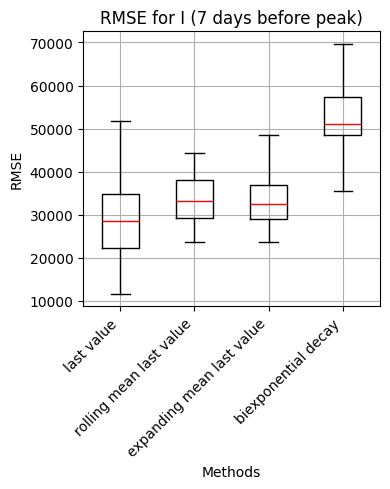

In [53]:
rmse_df = pd.DataFrame()

for beta_pred,new_label in zip(methods, new_labels):
    # loading data from CSV
    df = pd.read_csv(f'results/chel/start_{day}_{new_label}_results.csv')
    # add data to DataFrame with the column name as the method
    rmse_df[f"{beta_pred}"] = df['rmse_I']

# creating a boxplot
fig, ax = plt.subplots(1,1,figsize=(4,5))
box = ax.boxplot(rmse_df, showfliers=False, 
                 medianprops=dict(color='red'), widths=0.5)

ax.set_title(f'RMSE for I ({day} days before peak)')
ax.set_xlabel('Methods')
ax.set_ylabel('RMSE')
ax.set_xticks(ticks=np.arange(1, rmse_df.shape[1]+1), 
        labels=methods, rotation=45, ha='right')
ax.grid()

plt.tight_layout()
#plt.savefig(f'results/chel/start_day = {day}/rmse_I_boxplot.pdf', format='pdf', dpi=300, bbox_inches='tight')    

In [103]:
import choice_start_day

In [128]:
seed_dirs='full_chel_recalc/'
seed_df = pd.read_csv(seed_dirs + f'seirb_seed_{0}.csv')
seed_df = seed_df.iloc[:,:5].copy()
seed_df.columns = ['S','E','I','R','Beta']

start_day = choice_start_day.choose_method(seed_df, 7)
start_day = seed_df.I.argmax() - start_day
seed_df.Beta.isna().sum()

0

In [132]:
if seed_df[(seed_df.E==0)&(seed_df.I==0)].shape[0]:
    print(1)

In [120]:
seed_df.iloc[:91]

,S,E,I,R,Beta
0,155988.0,2.0,10.0,44000.0,-0.000000
1,155986.0,4.0,10.0,44000.0,0.000001
2,155959.0,29.0,12.0,44000.0,0.000014
3,155959.0,27.0,14.0,44000.0,-0.000000
4,155924.0,35.0,41.0,44000.0,0.000005
...,...,...,...,...,...
86,20201.0,0.0,3.0,179796.0,-0.000000
87,20201.0,0.0,2.0,179797.0,-0.000000
88,20201.0,0.0,2.0,179797.0,-0.000000
89,20201.0,0.0,2.0,179797.0,-0.000000


last value


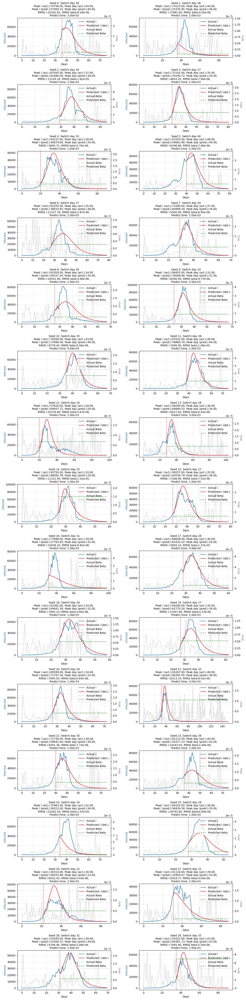

rolling mean last value


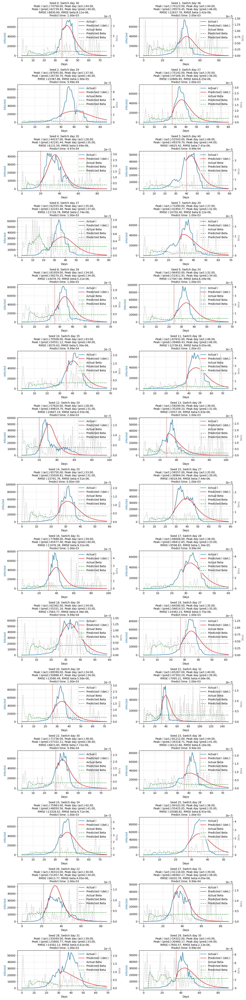

expanding mean last value


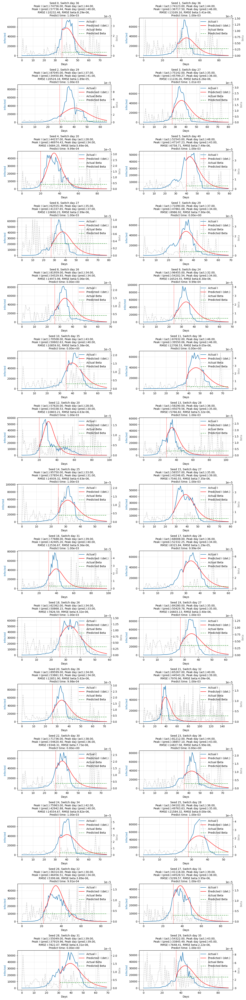

biexponential decay


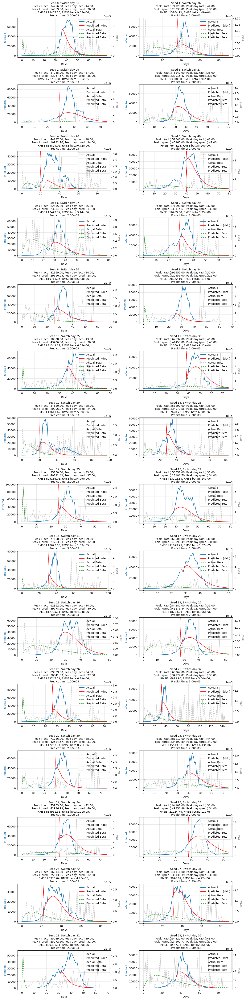

In [123]:
methods = ['last value', 'rolling mean last value',
           'expanding mean last value', 'biexponential decay']
            #'median beta', 'median beta;\nshifted forecast']
new_labels = ['last_value', 'rolling_mean_last_value',
                'expanding_mean_last_value', 'biexponential_decay'] 
                #'median_beta', 'median_beta_shifted_forecast']

seed_numbers = np.arange(30)
day = 7

for beta_pred, new_label in zip(methods, new_labels):
    all_rmse_I, all_rmse_Beta, \
        all_peak, execution_time, \
            start_days = plot_hyb.main_f(I_prediction_method='seir', 
                                stochastic=False, count_stoch_line=0, 
                                beta_prediction_method=beta_pred, 
                                type_start_day=day, seed_numbers=seed_numbers, 
                                show_fig_flag=True,
                                seed_dirs='sampled_200k_recalc/', 
                                sigma=1/2, gamma=1/6)
    
    # creating a dataframe for peaks
    all_peak = pd.DataFrame(all_peak, columns=['actual_peak_I', 'predicted_peak_I', 
                                               'actual_peak_day', 'predicted_peak_day'])

    rmse_df = pd.DataFrame({
        'rmse_I': all_rmse_I,
        'rmse_Beta': all_rmse_Beta,
        'time_predict': execution_time,
        f'{day}': start_days})

    # merging dataframes
    results = pd.concat([rmse_df, all_peak], axis=1)
    results.to_csv(f'results/samara/start_{day}_{new_label}_results.csv', index=False)

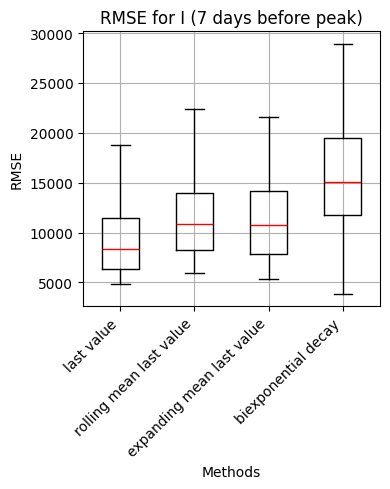

In [125]:
rmse_df = pd.DataFrame()

for beta_pred,new_label in zip(methods, new_labels):
    # loading data from CSV
    df = pd.read_csv(f'results/samara/start_{day}_{new_label}_results.csv')
    # add data to DataFrame with the column name as the method
    rmse_df[f"{beta_pred}"] = df['rmse_I']

# creating a boxplot
fig, ax = plt.subplots(1,1,figsize=(4,5))
box = ax.boxplot(rmse_df, showfliers=False, 
                 medianprops=dict(color='red'), widths=0.5)

ax.set_title(f'RMSE for I ({day} days before peak)')
ax.set_xlabel('Methods')
ax.set_ylabel('RMSE')
ax.set_xticks(ticks=np.arange(1, rmse_df.shape[1]+1), 
        labels=methods, rotation=45, ha='right')
ax.grid()

plt.tight_layout()
#plt.savefig(f'results/chel/start_day = {day}/rmse_I_boxplot.pdf', format='pdf', dpi=300, bbox_inches='tight')    

last value


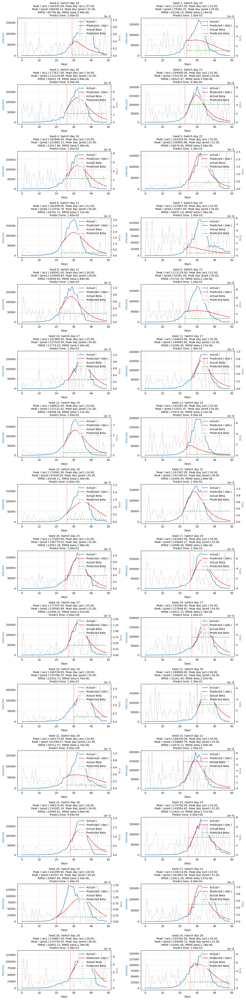

rolling mean last value


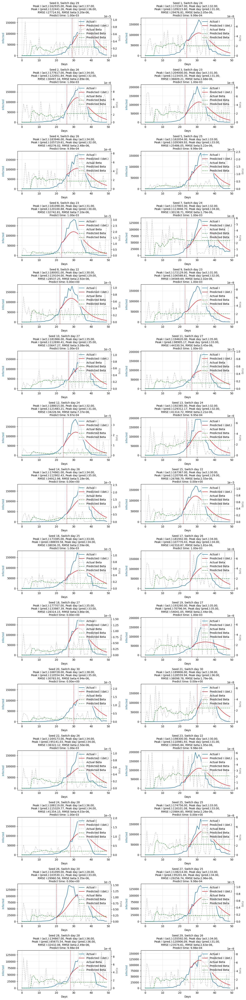

expanding mean last value


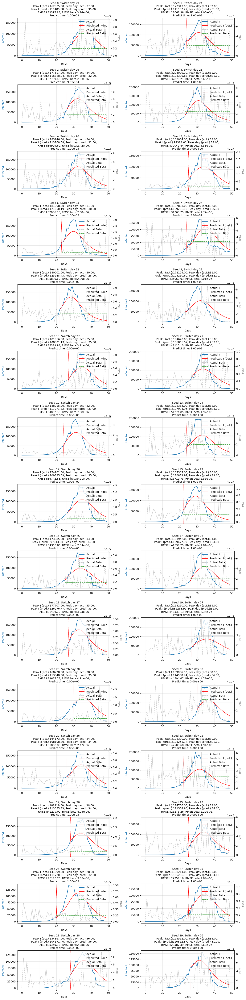

biexponential decay


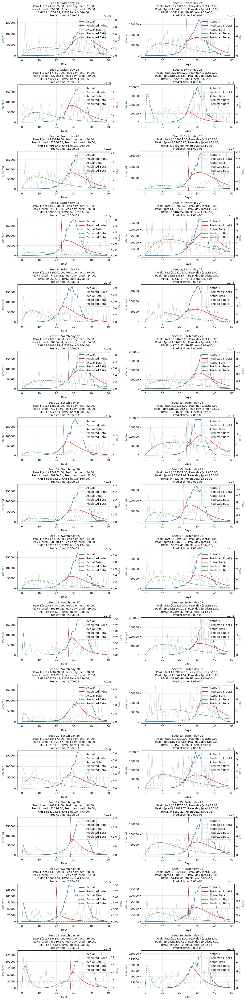

In [133]:
methods = ['last value', 'rolling mean last value',
           'expanding mean last value', 'biexponential decay']
            #'median beta', 'median beta;\nshifted forecast']
new_labels = ['last_value', 'rolling_mean_last_value',
                'expanding_mean_last_value', 'biexponential_decay'] 
                #'median_beta', 'median_beta_shifted_forecast']

seed_numbers = np.arange(30)
day = 7

for beta_pred, new_label in zip(methods, new_labels):
    all_rmse_I, all_rmse_Beta, \
        all_peak, execution_time, \
            start_days = plot_hyb.main_f(I_prediction_method='seir', 
                                stochastic=False, count_stoch_line=0, 
                                beta_prediction_method=beta_pred, 
                                type_start_day=day, seed_numbers=seed_numbers, 
                                show_fig_flag=True,
                                seed_dirs='full_chel_recalc/', 
                                sigma=1/2, gamma=1/6)
    
    # creating a dataframe for peaks
    all_peak = pd.DataFrame(all_peak, columns=['actual_peak_I', 'predicted_peak_I', 
                                               'actual_peak_day', 'predicted_peak_day'])

    rmse_df = pd.DataFrame({
        'rmse_I': all_rmse_I,
        'rmse_Beta': all_rmse_Beta,
        'time_predict': execution_time,
        f'{day}': start_days})

    # merging dataframes
    results = pd.concat([rmse_df, all_peak], axis=1)
    results.to_csv(f'results/chel/start_{day}_{new_label}_results.csv', index=False)

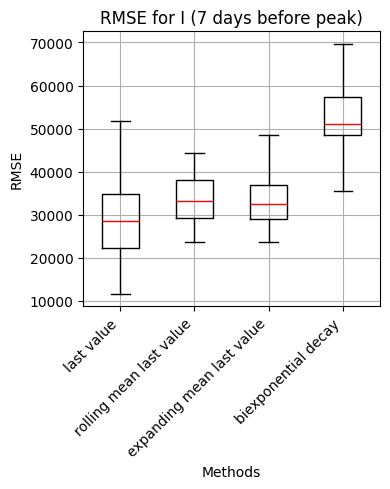

In [134]:
rmse_df = pd.DataFrame()

for beta_pred,new_label in zip(methods, new_labels):
    # loading data from CSV
    df = pd.read_csv(f'results/chel/start_{day}_{new_label}_results.csv')
    # add data to DataFrame with the column name as the method
    rmse_df[f"{beta_pred}"] = df['rmse_I']

# creating a boxplot
fig, ax = plt.subplots(1,1,figsize=(4,5))
box = ax.boxplot(rmse_df, showfliers=False, 
                 medianprops=dict(color='red'), widths=0.5)

ax.set_title(f'RMSE for I ({day} days before peak)')
ax.set_xlabel('Methods')
ax.set_ylabel('RMSE')
ax.set_xticks(ticks=np.arange(1, rmse_df.shape[1]+1), 
        labels=methods, rotation=45, ha='right')
ax.grid()

plt.tight_layout()
#plt.savefig(f'results/chel/start_day = {day}/rmse_I_boxplot.pdf', format='pdf', dpi=300, bbox_inches='tight')    

In [139]:
methods0  =['$\mathregular{M_{last\_val}}$',
    '$\mathregular{M_{ma\_val}}$',
    '$\mathregular{M_{ca\_val}}$',
    '$\mathregular{M_{biexp}}$']

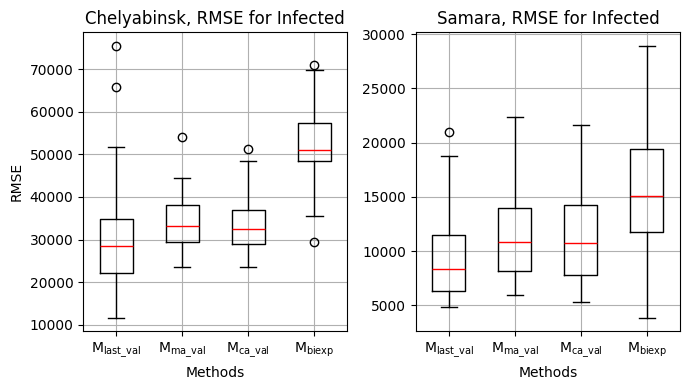

In [154]:
# creating a boxplot
fig, axes = plt.subplots(1,2,figsize=(7,4))
ax = axes.flatten()

for idx,city,city_l in zip([0,1], ['chel','samara'],
                          ['Chelyabinsk','Samara']):
    rmse_df = pd.DataFrame()

    for beta_pred,new_label in zip(methods0, new_labels):
        # loading data from CSV
        df = pd.read_csv(f'results/{city}/start_{day}_{new_label}_results.csv')
        # add data to DataFrame with the column name as the method
        rmse_df[f"{beta_pred}"] = df['rmse_I']

    box = ax[idx].boxplot(rmse_df, showfliers=True, 
                     medianprops=dict(color='red'), widths=0.5)

    ax[idx].set_title(f'{city_l}, RMSE for Infected')
    ax[idx].set_xlabel('Methods')
    if idx==0:
        ax[idx].set_ylabel('RMSE')
    ax[idx].set_xticks(ticks=np.arange(1, rmse_df.shape[1]+1), 
            labels=methods0, rotation=0, ha='center')
    ax[idx].grid()



plt.tight_layout()
plt.savefig(f'results/rmse_I_boxplot_both.pdf', 
            format='pdf', dpi=300, bbox_inches='tight')    

In [263]:
import math
import matplotlib as mpl
from scipy.spatial import ConvexHull

In [266]:
cmap(np.linspace(0, 1, 8))

array([[0.4       , 0.76078431, 0.64705882, 1.        ],
       [0.98823529, 0.55294118, 0.38431373, 1.        ],
       [0.55294118, 0.62745098, 0.79607843, 1.        ],
       [0.90588235, 0.54117647, 0.76470588, 1.        ],
       [0.65098039, 0.84705882, 0.32941176, 1.        ],
       [1.        , 0.85098039, 0.18431373, 1.        ],
       [0.89803922, 0.76862745, 0.58039216, 1.        ],
       [0.70196078, 0.70196078, 0.70196078, 1.        ]])

last value
6 25.0
rolling mean last value
6 25.0
expanding mean last value
6 25.0
biexponential decay
6 25.0


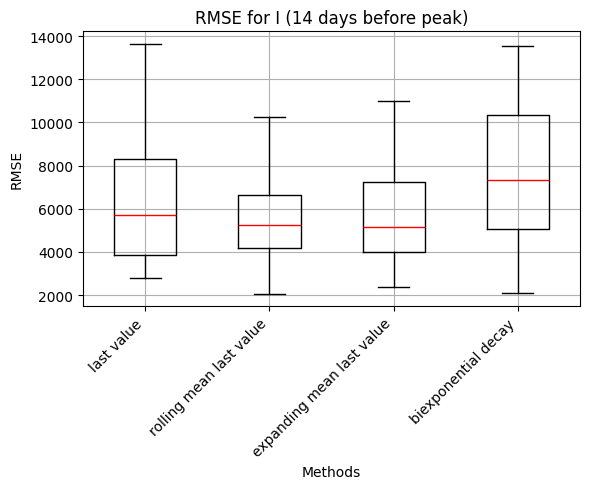

In [260]:
methods = ['last value', 'rolling mean last value',
           'expanding mean last value', 'biexponential decay']
            #'median beta', 'median beta;\nshifted forecast']
new_labels = ['last_value', 'rolling_mean_last_value',
                'expanding_mean_last_value', 'biexponential_decay'] 
                #'median_beta', 'median_beta_shifted_forecast']

seed_numbers = np.arange(30)
day = 14

for beta_pred, new_label in zip(methods, new_labels):
    all_rmse_I, all_rmse_Beta, \
        all_peak, execution_time, \
            start_days = plot_hyb.main_f(I_prediction_method='seir', 
                                stochastic=False, count_stoch_line=0, 
                                beta_prediction_method=beta_pred, 
                                type_start_day=day, seed_numbers=seed_numbers, 
                                show_fig_flag=False,
                                seed_dirs='sampled_200k_res_recalc/', 
                                sigma=1/2, gamma=1/6)
    
    # creating a dataframe for peaks
    all_peak = pd.DataFrame(all_peak, columns=['actual_peak_I', 'predicted_peak_I', 
                                               'actual_peak_day', 'predicted_peak_day'])

    rmse_df = pd.DataFrame({
        'rmse_I': all_rmse_I,
        'rmse_Beta': all_rmse_Beta,
        'time_predict': execution_time,
        f'{day}': start_days})

    # merging dataframes
    results = pd.concat([rmse_df, all_peak], axis=1)
    results.to_csv(f'results/samara/start_{day}_{new_label}_results.csv', index=False)
    
    

rmse_df = pd.DataFrame()

for beta_pred,new_label in zip(methods, new_labels):
    # loading data from CSV
    df = pd.read_csv(f'results/samara/start_{day}_{new_label}_results.csv')
    # add data to DataFrame with the column name as the method
    rmse_df[f"{beta_pred}"] = df['rmse_I']

# creating a boxplot
fig, ax = plt.subplots(1,1,figsize=(6,5))
box = ax.boxplot(rmse_df, showfliers=False, 
                 medianprops=dict(color='red'), widths=0.5)

ax.set_title(f'RMSE for I ({day} days before peak)')
ax.set_xlabel('Methods')
ax.set_ylabel('RMSE')
ax.set_xticks(ticks=np.arange(1, rmse_df.shape[1]+1), 
        labels=methods, rotation=45, ha='right')
ax.grid()

plt.tight_layout()
#plt.savefig(f'results/chel/start_day = {day}/rmse_I_boxplot.pdf', format='pdf', dpi=300, bbox_inches='tight')    

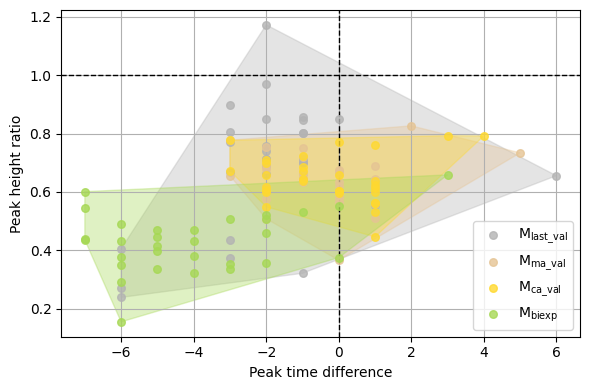

In [278]:
fig, ax = plt.subplots(1,1,figsize=(6, 4))

ax.axvline(x=0, color='black', linestyle='--', 
           linewidth=1)
ax.axhline(y=1, color='black', linestyle='--', 
           linewidth=1)

city = 'chel'

methods = ['$\mathregular{M_{last\_val}}$','$\mathregular{M_{ma\_val}}$',
    '$\mathregular{M_{ca\_val}}$','$\mathregular{M_{biexp}}$']
new_labels = ['last_value','rolling_mean_last_value',
    'expanding_mean_last_value','biexponential_decay']


cmap = mpl.colormaps['Set2']
colors = cmap(np.linspace(0, 1, 8))
colors = list(colors)

day = 7

for new_label, method in zip(new_labels, methods):
    p_df = pd.read_csv(f'results/{city}/start_{day}_{new_label}_results.csv')
    pt = p_df['predicted_peak_day'] - p_df['actual_peak_day']
    ph = p_df['predicted_peak_I']/p_df['actual_peak_I']
    
    hull = ConvexHull(pd.concat([pt,ph], axis=1))
    
    col = colors.pop()
    ax.scatter(pt,ph, marker='.', s=120,  alpha=.8, 
               label=method, zorder=10, color=col)

    ax.fill(pt.iloc[hull.vertices], 
             ph.iloc[hull.vertices], alpha=0.35, color=col)

ax.grid()
ax.set_xlabel('Peak time difference')
ax.set_ylabel('Peak height ratio')
ax.legend()


plt.tight_layout()
#plt.savefig(f'results/{switch}/peaks_area.pdf', format='pdf', bbox_inches='tight')

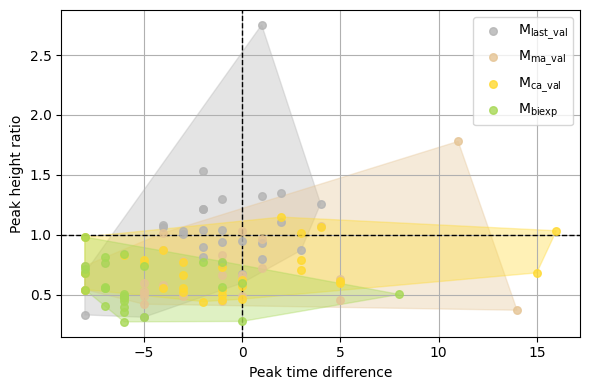

In [279]:
fig, ax = plt.subplots(1,1,figsize=(6, 4))

ax.axvline(x=0, color='black', linestyle='--', 
           linewidth=1)
ax.axhline(y=1, color='black', linestyle='--', 
           linewidth=1)

city = 'samara'

methods = ['$\mathregular{M_{last\_val}}$','$\mathregular{M_{ma\_val}}$',
    '$\mathregular{M_{ca\_val}}$','$\mathregular{M_{biexp}}$']
new_labels = ['last_value','rolling_mean_last_value',
    'expanding_mean_last_value','biexponential_decay']


cmap = mpl.colormaps['Set2']
colors = cmap(np.linspace(0, 1, 8))
colors = list(colors)

day = 7

for new_label, method in zip(new_labels, methods):
    p_df = pd.read_csv(f'results/{city}/start_{day}_{new_label}_results.csv')
    pt = p_df['predicted_peak_day'] - p_df['actual_peak_day']
    ph = p_df['predicted_peak_I']/p_df['actual_peak_I']
    
    hull = ConvexHull(pd.concat([pt,ph], axis=1))
    
    col = colors.pop()
    ax.scatter(pt,ph, marker='.', s=120,  alpha=.8, 
               label=method, zorder=10, color=col)

    ax.fill(pt.iloc[hull.vertices], 
             ph.iloc[hull.vertices], alpha=0.35, color=col)

ax.grid()
ax.set_xlabel('Peak time difference')
ax.set_ylabel('Peak height ratio')
ax.legend()


plt.tight_layout()
#plt.savefig(f'results/{switch}/peaks_area.pdf', format='pdf', bbox_inches='tight')

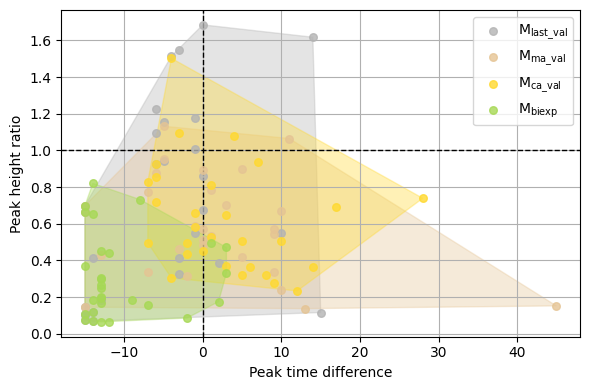

In [280]:
fig, ax = plt.subplots(1,1,figsize=(6, 4))

ax.axvline(x=0, color='black', linestyle='--', 
           linewidth=1)
ax.axhline(y=1, color='black', linestyle='--', 
           linewidth=1)

city = 'samara'

methods = ['$\mathregular{M_{last\_val}}$','$\mathregular{M_{ma\_val}}$',
    '$\mathregular{M_{ca\_val}}$','$\mathregular{M_{biexp}}$']
new_labels = ['last_value','rolling_mean_last_value',
    'expanding_mean_last_value','biexponential_decay']


cmap = mpl.colormaps['Set2']
colors = cmap(np.linspace(0, 1, 8))
colors = list(colors)

day = 14

for new_label, method in zip(new_labels, methods):
    p_df = pd.read_csv(f'results/{city}/start_{day}_{new_label}_results.csv')
    pt = p_df['predicted_peak_day'] - p_df['actual_peak_day']
    ph = p_df['predicted_peak_I']/p_df['actual_peak_I']
    
    hull = ConvexHull(pd.concat([pt,ph], axis=1))
    
    col = colors.pop()
    ax.scatter(pt,ph, marker='.', s=120,  alpha=.8, 
               label=method, zorder=10, color=col)

    ax.fill(pt.iloc[hull.vertices], 
             ph.iloc[hull.vertices], alpha=0.35, color=col)

ax.grid()
ax.set_xlabel('Peak time difference')
ax.set_ylabel('Peak height ratio')
ax.legend()


plt.tight_layout()
#plt.savefig(f'results/{switch}/peaks_area.pdf', format='pdf', bbox_inches='tight')